In [1]:
import numpy as np
from sklearn.svm import SVC
from utilities import *
from sklearn.manifold import TSNE

In [2]:
X_train, X_test, y_train, y_test = prepare_data(get_pT=False)

found preprepared data in ..\data\ZMUMU_EGZ_extended_np_pd


In [3]:
svm_classifier = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
svm_classifier.fit(X_train, y_train)

SVC(random_state=42)

In [4]:
y_pred = svm_classifier.predict(X_test)

In [5]:
evaluate_sklearn_model(y_test, y_pred)

Accuracy: 0.96518124
Recall: 0.98048031
Precision: 0.93159944
F1 Score: 0.95541507
Classification Report:
               precision    recall  f1-score   support

         0.0       0.99      0.96      0.97     28610
         1.0       0.93      0.98      0.96     17572

    accuracy                           0.97     46182
   macro avg       0.96      0.97      0.96     46182
weighted avg       0.97      0.97      0.97     46182

Confusion Matrix:
 [[27345  1265]
 [  343 17229]]
Mean Squared Error: 0.0348



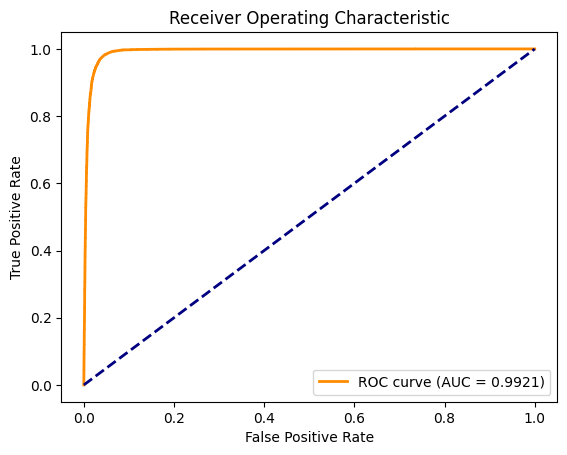

In [6]:
fpr, tpr, roc_auc = compute_roc(svm_classifier, X_test, y_test)
plot_roc(fpr, tpr, roc_auc)

In [7]:
X_test_embedded = TSNE(n_components=2, random_state=42).fit_transform(X_test) 

In [8]:
X_test_embedded_3D = TSNE(n_components=3, random_state=42).fit_transform(X_test)

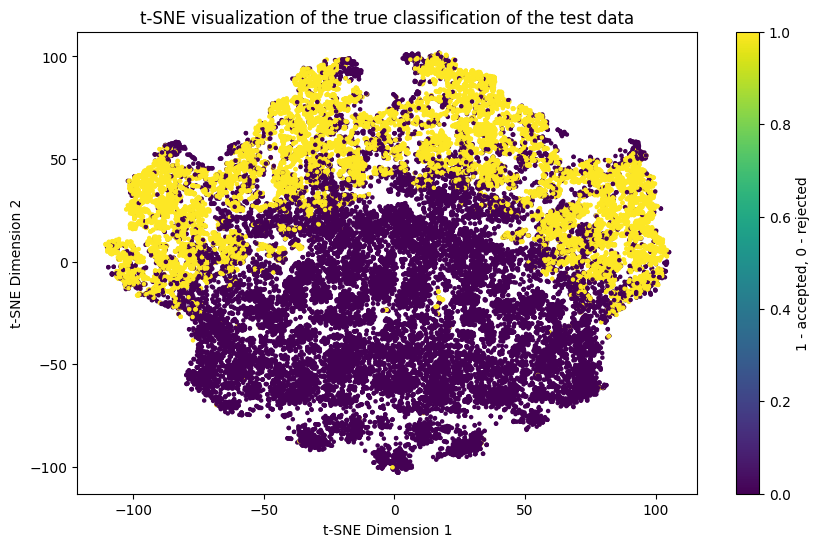

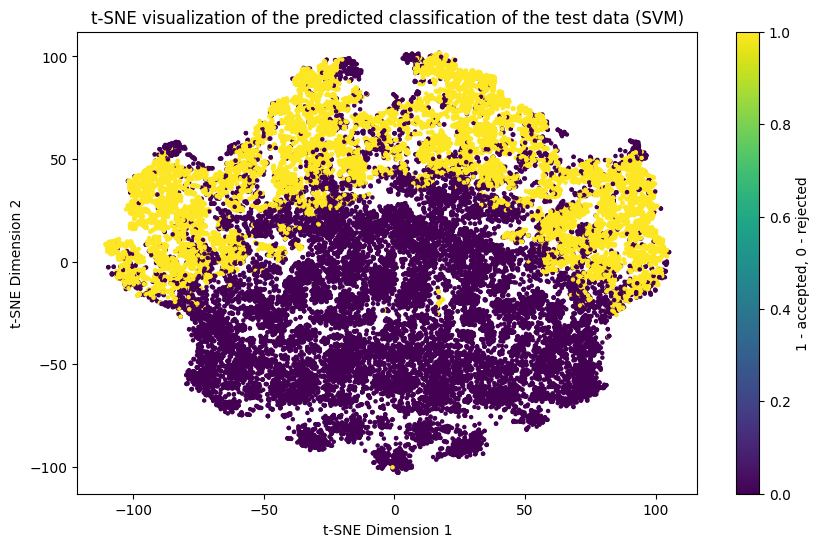

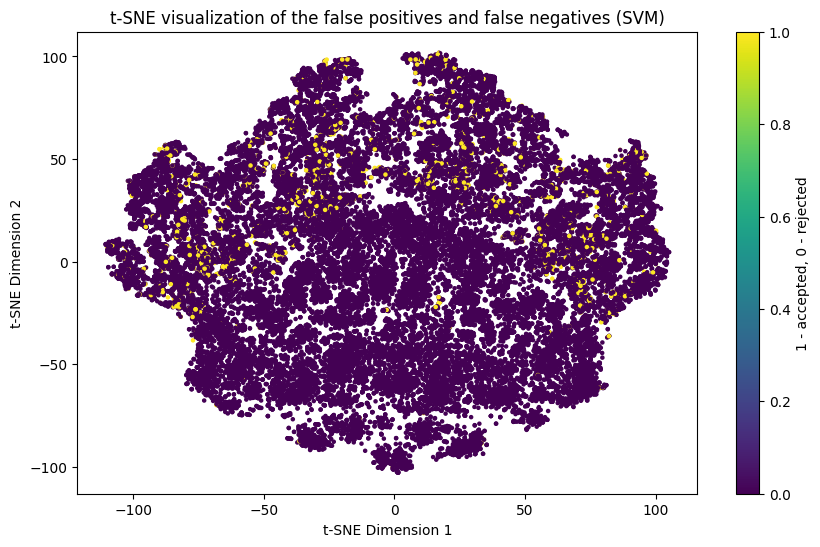

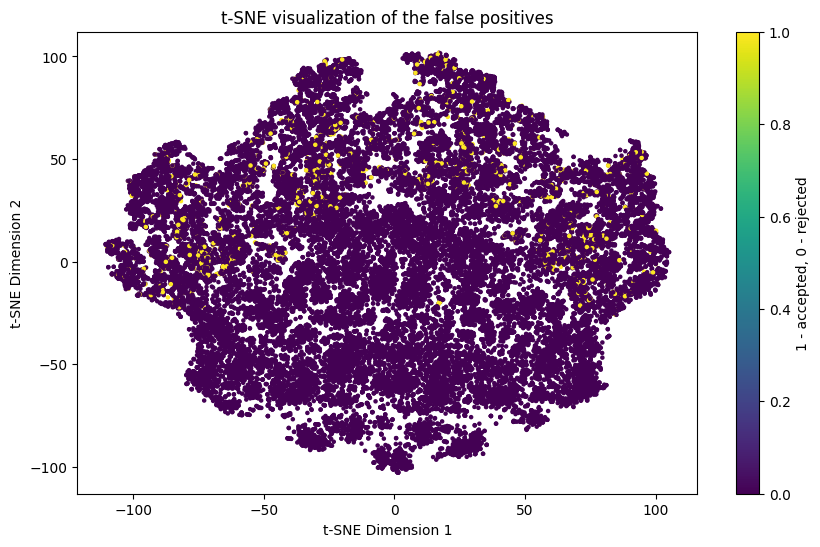

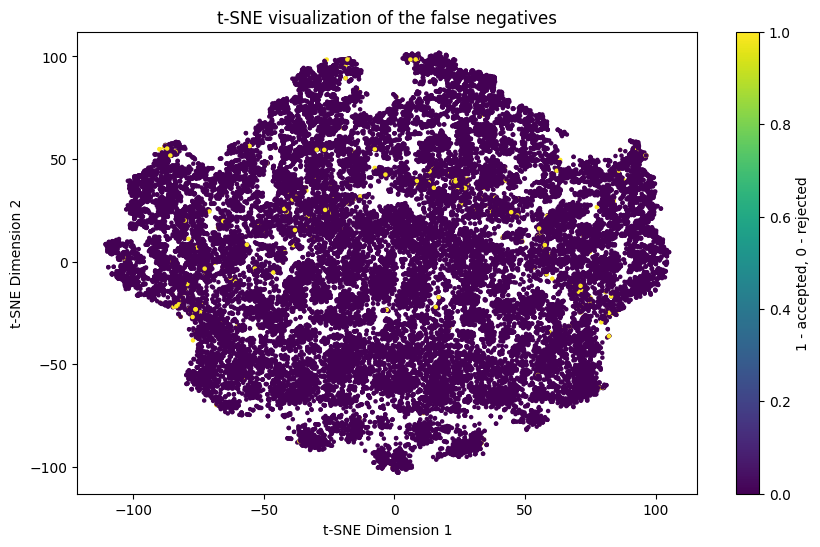

In [9]:
y_fpfn = np.logical_xor(y_test, y_pred)
y_fn = np.logical_and(y_test,np.logical_not(y_pred))
y_fp = np.logical_and(np.logical_not(y_test), y_pred)

plot_2D_TSNE(X_test_embedded,y_test,"t-SNE visualization of the true classification of the test data")
plot_2D_TSNE(X_test_embedded,y_pred,"t-SNE visualization of the predicted classification of the test data (SVM)")
plot_2D_TSNE(X_test_embedded,y_fpfn,"t-SNE visualization of the false positives and false negatives (SVM)")
plot_2D_TSNE(X_test_embedded,y_fp,"t-SNE visualization of the false positives")
plot_2D_TSNE(X_test_embedded,y_fn,"t-SNE visualization of the false negatives")

plot_3D_TSNE(X_test_embedded_3D, y_test)
plot_3D_TSNE(X_test_embedded_3D, y_pred)
plot_3D_TSNE(X_test_embedded_3D, y_fpfn)
plot_3D_TSNE(X_test_embedded_3D, y_fp)
plot_3D_TSNE(X_test_embedded_3D, y_fn)